# Install Tensorflow 2.3.0

In [2]:
#import tensorflow as tf
#print(tf.__version__)

In [3]:
#!pip uninstall tensorflow

In [4]:
#!pip install tensorflow==2.3.0

In [1]:
import tensorflow as tf
print(tf.__version__)

2.3.0


# Running DeepSort Object Tracking with YOLO Object Detections in Google Colab!
This tutorial will help you run DeepSort Object tracking on Colab GPU with YOLOv4 Object Detections. 

Object tracking implemented with YOLOv4, DeepSort, and TensorFlow. YOLOv4 is a state of the art algorithm that uses deep convolutional neural networks to perform object detections. We can take the output of YOLOv4 feed these object detections into Deep SORT (Simple Online and Realtime Tracking with a Deep Association Metric) in order to create a highly accurate object tracker.

## Step 1: Enabling GPU within your notebook
You will want to enable GPU acceleration within your Colab notebook so that your object tracker will be able to process detections over 100 times faster than if it were on CPU.

### Steps:

### i) Click **Edit** at top left of your notebook
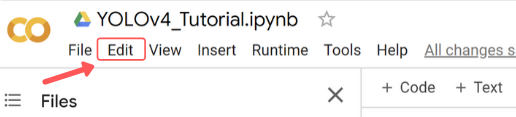
### ii) Click **Notebook Settings** within dropdown
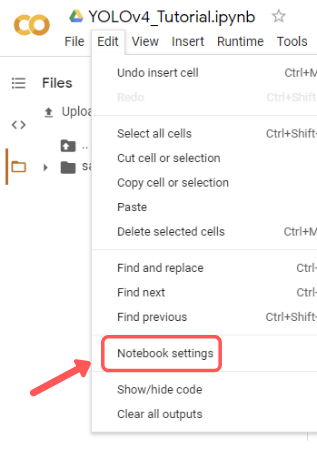
### iii) Under 'Hardware Accelerator' select **GPU** and then hit **Save**
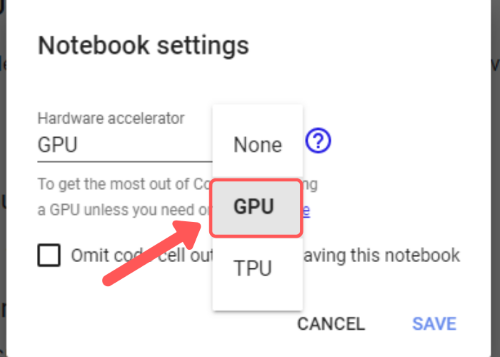

Your notebook should now have GPU enabled!

## Step 2: Cloning the Repository
The following cell will clone the yolov4-deepsort repository from github, to enable the rest of the tutorial and grab the code.

In [ ]:
# clone repository for deepsort with yolov4
#!git clone https://github.com/theAIGuysCode/yolov4-deepsort

Cloning into 'yolov4-deepsort'...
remote: Enumerating objects: 143, done.
remote: Total 143 (delta 0), reused 0 (delta 0), pack-reused 143
Receiving objects: 100% (143/143), 76.84 MiB | 6.51 MiB/s, done.
Resolving deltas: 100% (41/41), done.


In [7]:
# step into the yolov4-deepsort folder
%cd C:/Users/Consultant/yolov4-deepsort/

C:\Users\Consultant\yolov4-deepsort


## Step 3: Install Dependencies
Google Colab should have all the necessary dependencies installed already within your notebook. I have left this section here as a backup plan if for some reason you run into any dependency issues while running DeepSort.

In [ ]:
# uncomment below line ONLY if you run into any dependency issues while following tutorial
#!pip install -r requirements-gpu.txt

In [13]:
import cv2

In [8]:
import tensorflow as tf
print(tf.__version__)

2.3.0


## Step 4: Get YOLOv4 Pre-trained Weights
For this tutorial we will be using the pre-trained YOLOv4 model, trained on over 80 classes.

In [9]:
# download yolov4 model weights to data folder
# !wget https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.weights -P data/

## Step 5: Convert YOLOv4 Darknet Weights to TensorFlow model
We will be running the DeepSort object tracker using TensorFlow. In order to accomplish this we must first convert the yolov4 weights into a tensorflow model.

In [ ]:
# Convert darknet weights to tensorflow model
#!python save_model.py --model yolov4

2022-07-07 22:37:47.080088: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2022-07-07 22:37:48.256894: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2022-07-07 22:37:48.275229: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-07 22:37:48.275854: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2022-07-07 22:37:48.275891: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2022-07-07 22:37:48.278101: I tensorflow/stream_executor/pl

## Step 6: Running DeepSort with YOLOv4

Let the fun begin! You can now run your object tracker. Unfortunately Google Colab doesn't support displaying video while its being processed. So we will be suppressing the output of the object tracker as it runs and then we will display the entire video once it has finished processing.

In [3]:
#!python object_tracker.py --video ./data/video/cars.mp4 --output ./outputs/demo_cars.avi --model yolov4  --dont_show --info

Frame #:  1
FPS: 0.27
Frame #:  2
FPS: 0.58
Frame #:  3
Tracker ID: 1, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (1215, 467, 1508, 680)
Tracker ID: 2, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (788, 567, 1082, 802)
Tracker ID: 3, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (908, 300, 1116, 464)
Tracker ID: 4, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (850, 881, 1223, 1078)
Tracker ID: 5, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (610, 411, 913, 598)
Tracker ID: 6, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (577, 340, 797, 520)
Tracker ID: 7, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (493, 275, 678, 449)
FPS: 0.58
Frame #:  4
Tracker ID: 1, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (1220, 470, 1513, 683)
Tracker ID: 2, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (789, 572, 1085, 810)
Tracker ID: 3, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (910, 300, 1118, 464)
Tracker ID: 4, Class: car,  BBox Coords (x

In [4]:
# run DeepSort with YOLOv4 Object Detections as backbone (enable --info flag to see info about tracked objects)
!python object_tracker.py --video ./data/video/traffic.mp4 --output ./outputs/traffic.avi --model yolov4 --dont_show --info

Frame #:  1
Objects being tracked: 5
FPS: 0.48
Frame #:  2
Objects being tracked: 5
FPS: 1.06
Frame #:  3
Objects being tracked: 5
Tracker ID: 1, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (687, 288, 709, 315)
Tracker ID: 2, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (565, 297, 595, 318)
Tracker ID: 3, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (710, 275, 730, 292)
Tracker ID: 4, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (597, 274, 614, 288)
Tracker ID: 5, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (624, 260, 642, 272)
FPS: 1.08
Frame #:  4
Objects being tracked: 6
Tracker ID: 1, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (686, 286, 709, 314)
Tracker ID: 2, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (563, 298, 594, 318)
Tracker ID: 3, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (710, 274, 731, 293)
Tracker ID: 4, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (598, 275, 612, 288)
Tracker ID: 5, Class: car,  BBox Coords

Frame #:  516
Objects being tracked: 3
Tracker ID: 89, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (500, 337, 541, 364)
Tracker ID: 90, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (689, 270, 708, 289)
FPS: 1.08
Frame #:  517
Objects being tracked: 3
Tracker ID: 89, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (499, 337, 541, 365)
Tracker ID: 90, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (689, 270, 708, 288)
Tracker ID: 106, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (564, 300, 587, 314)
FPS: 1.08
Frame #:  518
Objects being tracked: 5
Tracker ID: 89, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (496, 338, 542, 368)
Tracker ID: 90, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (689, 270, 708, 288)
Tracker ID: 106, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (562, 299, 588, 314)
FPS: 1.04
Frame #:  519
Objects being tracked: 4
Tracker ID: 89, Class: car,  BBox Coords (xmin, ymin, xmax, ymax): (495, 339, 542, 370)
Tracker ID: 90, Clas

In [21]:
import time
t0= time.time()
print("Hello")


Hello


In [4]:
import time
t0= time.time()
print("Hello")

dirty_list=!python object_tracker.py --video ./data/video/traffic_Trim.mp4 --output ./outputs/traffic_Trim.avi --model yolov4 --dont_show --info

t1 = time.time()
print("Time elapsed: ", t1 - t0)

Hello
Time elapsed:  186.3626992702484


Time elapsed:  1.6328926086425781


In [5]:
frames=[x for x in dirty_list if 'Frame' in x]
objects=[x for x in dirty_list if 'Objects' in x]

In [6]:

numbers= [int(x[22:]) for x in objects]

In [7]:
import pandas as pd 

In [9]:
pd.DataFrame(numbers).to_csv('frames_count.csv')

In [4]:
# define helper function to display videos
import io 
from IPython.display import HTML
from base64 import b64encode
def show_video(file_name, width=640):
  # show resulting deepsort video
  mp4 = open(file_name,'rb').read()
  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
  return HTML("""
  <video width="{0}" controls>
        <source src="{1}" type="video/mp4">
  </video>
  """.format(width, data_url))

In [17]:
test=cola[-3]

In [20]:
test.split()[2] 

'15,'

In [8]:
cola= !python object_tracker.py --video ./data/video/cars.mp4 --output ./outputs/car_tracker.avi --model yolov4 --dont_show --info

In [2]:
# convert resulting video from avi to mp4 file format
import os
path_video = os.path.join("outputs","tracker.avi")
%cd outputs/
!ffmpeg -y -loglevel panic -i demo_cars.avi output.mp4
%cd ..

C:\Users\Consultant\yolov4-deepsort\outputs
C:\Users\Consultant\yolov4-deepsort


'ffmpeg' is not recognized as an internal or external command,
operable program or batch file.


In [9]:



# output object tracking video
path_output = os.path.join("outputs","demo_cars.avi")
show_video(path_output, width=960)

## Bonus: Running DeepSort on Specific Classes (filter out unwanted classes)
You may not want to run your object tracker on all 80+ classes that the pre-trained YOLOv4 model is trained on. We can edit a couple lines of code in the object_tracker.py file to allow only certain classes to be tracked.

See what classes are available in pre-trained model: [COCO CLASSES](http://cocodataset.org/#explore)

To pick which classes to track, open object_tracker.py file by double clicking on it in the Files section of your notebook.

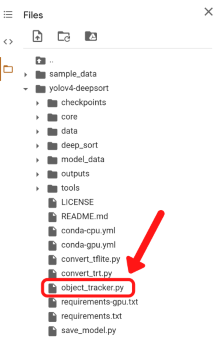

Scroll down to lines 160-163. Comment out line 160 and uncomment line 163, changing the list by adding any of the class names to the list in a comma separated fashion.

Below example would only allow object tracking of 'person's and 'car's.

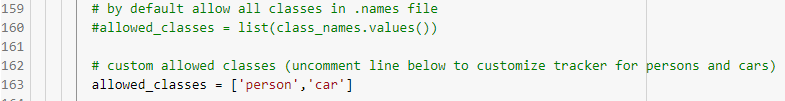
 
For the example I will show you, I have only allowed the class 'car's.

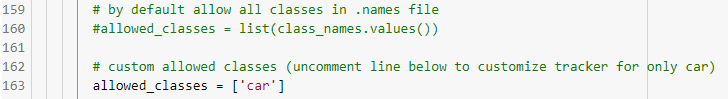

Now let's run the object tracker on a different video to test it out.

In [ ]:
# run object tracker on video of cars
!python object_tracker.py --video ./data/video/cars.mp4 --output ./outputs/custom.avi --model yolov4 --dont_show

Frame #:  1
FPS: 0.50
Frame #:  2
FPS: 19.96
Frame #:  3
FPS: 18.61
Frame #:  4
FPS: 17.86
Frame #:  5
FPS: 18.19
Frame #:  6
FPS: 17.30
Frame #:  7
FPS: 18.08
Frame #:  8
FPS: 16.84
Frame #:  9
FPS: 17.62
Frame #:  10
FPS: 16.11
Frame #:  11
FPS: 17.07
Frame #:  12
FPS: 17.99
Frame #:  13
FPS: 17.32
Frame #:  14
FPS: 17.14
Frame #:  15
FPS: 17.49
Frame #:  16
FPS: 17.25
Frame #:  17
FPS: 17.95
Frame #:  18
FPS: 18.38
Frame #:  19
FPS: 17.57
Frame #:  20
FPS: 16.67
Frame #:  21
FPS: 16.68
Frame #:  22
FPS: 17.57
Frame #:  23
FPS: 17.01
Frame #:  24
FPS: 16.07
Frame #:  25
FPS: 16.84
Frame #:  26
FPS: 16.49
Frame #:  27
FPS: 17.71
Frame #:  28
FPS: 16.56
Frame #:  29
FPS: 16.19
Frame #:  30
FPS: 16.94
Frame #:  31
FPS: 17.57
Frame #:  32
FPS: 15.99
Frame #:  33
FPS: 17.77
Frame #:  34
FPS: 16.52
Frame #:  35
FPS: 18.99
Frame #:  36
FPS: 16.71
Frame #:  37
FPS: 16.59
Frame #:  38
FPS: 15.82
Frame #:  39
FPS: 15.90
Frame #:  40
FPS: 15.73
Frame #:  41
FPS: 16.74
Frame #:  42
FPS: 17.19
Fr

In [ ]:
# convert resulting video from avi to mp4 file format
path_video = os.path.join("outputs","custom.avi")
%cd outputs/
!ffmpeg -y -loglevel panic -i custom.avi result.mp4
%cd ..

# output object tracking video
path_output = os.path.join("outputs","result.mp4")
show_video(path_output, width=960)

/content/yolov4-deepsort/yolov4-deepsort/outputs
/content/yolov4-deepsort/yolov4-deepsort


# Congrats!
Hope you enjoyed this tutorial! Congrats on getting an Object Tracker running using DeepSort and YOLOv4.

If you found this tutorial useful [click here to see my other tutorials!](https://www.youtube.com/channel/UCrydcKaojc44XnuXrfhlV8Q?sub_confirmation=1)

Thanks and all the best!